**Importing necessary libraries**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium

**Downloading Dataset**
* Importing the dataset with the help of pandas

In [2]:
data = pd.read_csv("/kaggle/input/us-accidents/US_Accidents_March23.csv")
data.head(5)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,...,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,...,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,...,False,False,False,False,True,False,Day,Day,Day,Day


**Data Prepration and Cleaning**
* Already loaded the file using pandas.
* Learning more about the dataset and understanding it.
* Look at some information about the file.
* Fix any missing or incorrect values

In [3]:
data.columns  # to understand the columns in the dataset

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [4]:
data.info() # To get the overview of the columns and its datatypes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 46 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   Severity               int64  
 3   Start_Time             object 
 4   End_Time               object 
 5   Start_Lat              float64
 6   Start_Lng              float64
 7   End_Lat                float64
 8   End_Lng                float64
 9   Distance(mi)           float64
 10  Description            object 
 11  Street                 object 
 12  City                   object 
 13  County                 object 
 14  State                  object 
 15  Zipcode                object 
 16  Country                object 
 17  Timezone               object 
 18  Airport_Code           object 
 19  Weather_Timestamp      object 
 20  Temperature(F)         float64
 21  Wind_Chill(F)          float64
 22  Humidity(%)       

In [5]:
data.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,7.728394e+06,7.728394e+06,7.728394e+06,4.325632e+06,4.325632e+06,7.728394e+06,7.564541e+06,5.729375e+06,7.554250e+06,7.587715e+06,7.551296e+06,7.157161e+06,5.524808e+06
mean,2.212384e+00,3.620119e+01,-9.470255e+01,3.626183e+01,-9.572557e+01,5.618423e-01,6.166329e+01,5.825105e+01,6.483104e+01,2.953899e+01,9.090376e+00,7.685490e+00,8.407210e-03
std,4.875313e-01,5.076079e+00,1.739176e+01,5.272905e+00,1.810793e+01,1.776811e+00,1.901365e+01,2.238983e+01,2.282097e+01,1.006190e+00,2.688316e+00,5.424983e+00,1.102246e-01
min,1.000000e+00,2.455480e+01,-1.246238e+02,2.456601e+01,-1.245457e+02,0.000000e+00,-8.900000e+01,-8.900000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.339963e+01,-1.172194e+02,3.346207e+01,-1.177543e+02,0.000000e+00,4.900000e+01,4.300000e+01,4.800000e+01,2.937000e+01,1.000000e+01,4.600000e+00,0.000000e+00
50%,2.000000e+00,3.582397e+01,-8.776662e+01,3.618349e+01,-8.802789e+01,3.000000e-02,6.400000e+01,6.200000e+01,6.700000e+01,2.986000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,4.008496e+01,-8.035368e+01,4.017892e+01,-8.024709e+01,4.640000e-01,7.600000e+01,7.500000e+01,8.400000e+01,3.003000e+01,1.000000e+01,1.040000e+01,0.000000e+00
max,4.000000e+00,4.900220e+01,-6.711317e+01,4.907500e+01,-6.710924e+01,4.417500e+02,2.070000e+02,2.070000e+02,1.000000e+02,5.863000e+01,1.400000e+02,1.087000e+03,3.647000e+01


In [6]:
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']

numeric_data = data.select_dtypes(include=numerics)
len(numeric_data.columns)                              # This is the numberic data in the dataset

13

**Percentage of missing values per column**

In [7]:
missing_values = data.isna().sum().sort_values(ascending=False)/len(data)  # this will give us the null values sum

mask = missing_values!= 0

missing_values1 = missing_values[mask]         # This will remove the zeros from the series
missing_values1

End_Lat                  4.402935e-01
End_Lng                  4.402935e-01
Precipitation(in)        2.851286e-01
Wind_Chill(F)            2.586590e-01
Wind_Speed(mph)          7.391355e-02
Visibility(mi)           2.291524e-02
Wind_Direction           2.267043e-02
Humidity(%)              2.253301e-02
Weather_Condition        2.244438e-02
Temperature(F)           2.120143e-02
Pressure(in)             1.820288e-02
Weather_Timestamp        1.555666e-02
Nautical_Twilight        3.007869e-03
Civil_Twilight           3.007869e-03
Sunrise_Sunset           3.007869e-03
Astronomical_Twilight    3.007869e-03
Airport_Code             2.928810e-03
Street                   1.406372e-03
Timezone                 1.010300e-03
Zipcode                  2.477876e-04
City                     3.273643e-05
Description              6.469649e-07
dtype: float64

<Axes: >

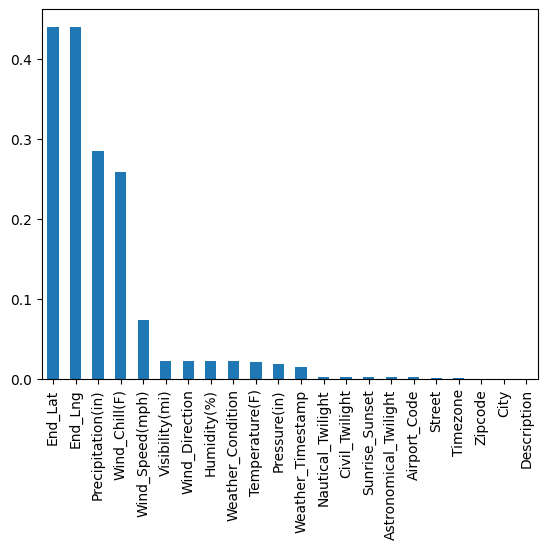

In [8]:
missing_values1.plot(kind='bar')

# ****Exploratory Data Analysis and Visulization****

**Columns to analyse**
* city
* Start time
* Start lat , start lon
* Temperature
* Weather condition

# 1. City

In [9]:
Cities = data['City'].nunique()
Cities

13678

In [10]:
cities_by_accident = data['City'].value_counts()
cities_by_accident.head(20)                     #Top 20 cities with max accidents

City
Miami            186917
Houston          169609
Los Angeles      156491
Charlotte        138652
Dallas           130939
Orlando          109733
Austin            97359
Raleigh           86079
Nashville         72930
Baton Rouge       71588
Atlanta           68186
Sacramento        66264
San Diego         55504
Phoenix           53974
Minneapolis       51488
Richmond          48845
Oklahoma City     46092
Jacksonville      42447
Tucson            39304
Columbia          38178
Name: count, dtype: int64

In [11]:
cities_by_accident_percentage = cities_by_accident/ len(data)
cities_by_accident_percentage 

City
Miami                           2.418575e-02
Houston                         2.194622e-02
Los Angeles                     2.024884e-02
Charlotte                       1.794060e-02
Dallas                          1.694259e-02
                                    ...     
Benkelman                       1.293930e-07
Old Appleton                    1.293930e-07
Wildrose                        1.293930e-07
Mc Nabb                         1.293930e-07
American Fork-Pleasant Grove    1.293930e-07
Name: count, Length: 13678, dtype: float64

<Axes: xlabel='City'>

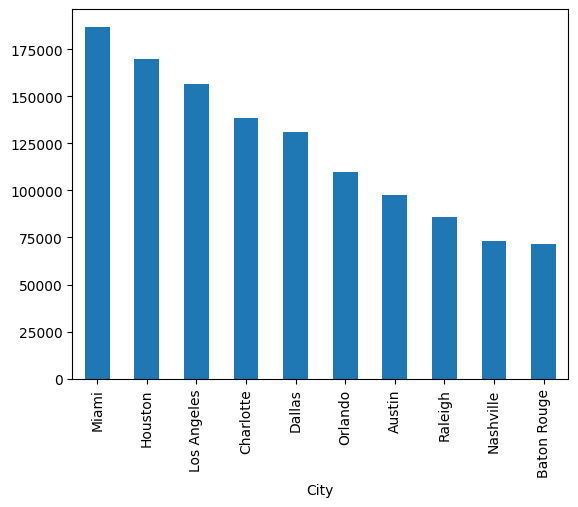

In [12]:
cities_by_accident.head(10).plot(kind='bar')

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


<Axes: xlabel='count', ylabel='Count'>

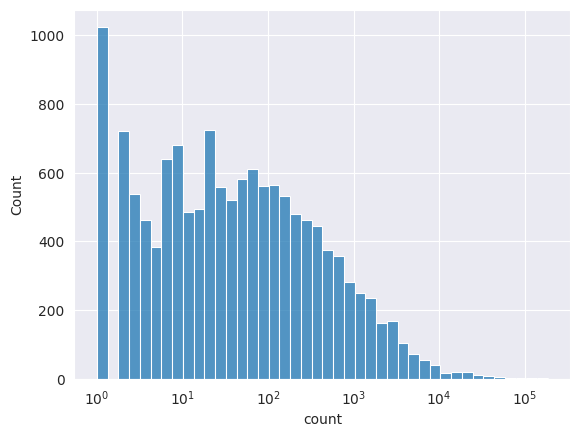

In [13]:
sns.set_style("darkgrid")
sns.histplot(cities_by_accident,  log_scale=True)

#log_scale=True, it means that the y-axis values are not linear but are scaled logarithmically.
#This is often used when dealing with data that spans a wide range of values

In [14]:
# Among the top 100 cities in number of accidents, which states do they belong to most frequently

Top_100_Cities = cities_by_accident[:100]
states = data[data['City'].isin(Top_100_Cities.index)]
print(states['State'].value_counts())

State
CA    623771
FL    521052
TX    478081
NC    226418
LA    124966
TN    120997
SC    110078
NY    105712
AZ     99137
MN     91956
GA     82144
OK     75014
MI     70129
OH     68740
VA     68421
PA     61787
MO     49535
OR     44285
WA     37797
IN     36186
IL     34015
AL     30442
CO     30088
NE     21812
KY     21415
UT     21015
DC     18428
WI     16178
NJ     11287
KS      6258
MD      1951
DE      1822
MA      1656
CT       867
MT       604
MS       530
AR       431
ME       418
NV       313
NH       186
IA       178
WV        84
VT        68
RI        24
ND        22
NM        17
SD         5
WY         3
Name: count, dtype: int64


# 2 - Start Time


* Shows start time of the accident in local time zone

In [15]:
print(data["Start_Time"].nunique())

6131796


In [16]:
top_10_start_time = data["Start_Time"].value_counts().head(10)
top_10_start_time

Start_Time
2021-01-26 16:16:13    225
2021-01-26 16:17:33    156
2021-02-16 06:42:43    139
2021-11-21 18:37:51    108
2020-12-16 13:53:25     96
2021-02-16 06:43:35     87
2021-05-03 06:29:42     80
2017-05-15 09:22:55     74
2020-09-30 12:41:30     66
2021-04-26 08:58:47     66
Name: count, dtype: int64

In [17]:
data['Start_Time'] = pd.to_datetime(data['Start_Time'], format='mixed')
print(data['Start_Time'].dtype)

datetime64[ns]


In [18]:
data_year = data['Start_Time'].dt.year.value_counts()
data_year

Start_Time
2022    1762452
2021    1563753
2020    1178913
2019     954303
2018     893426
2017     718093
2016     410821
2023     246633
Name: count, dtype: int64

In [19]:
data_month = data['Start_Time'].dt.month.value_counts()
data_month

Start_Time
12    847343
11    760165
1     751946
10    675130
2     658984
9     651381
8     599666
4     587300
6     571373
5     558176
3     554595
7     512335
Name: count, dtype: int64

<function matplotlib.pyplot.show(close=None, block=None)>

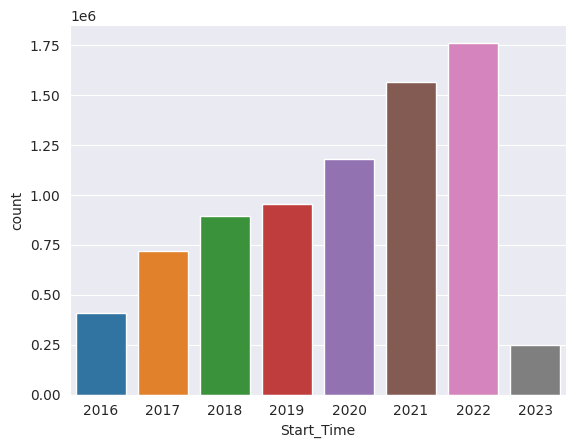

In [20]:
sns.countplot(x = data['Start_Time'].dt.year , data = data)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

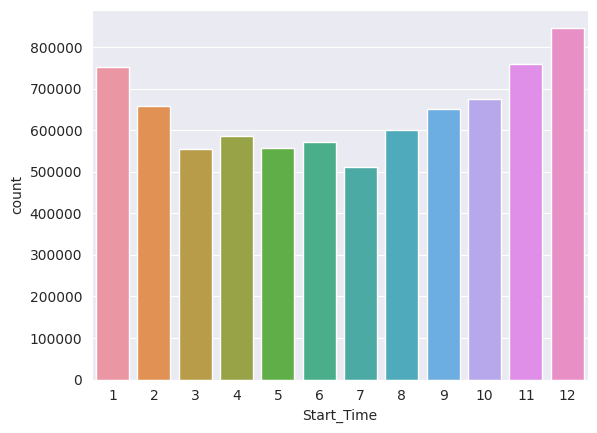

In [21]:
sns.countplot(x = data['Start_Time'].dt.month , data = data)
plt.show

<Axes: ylabel='count'>

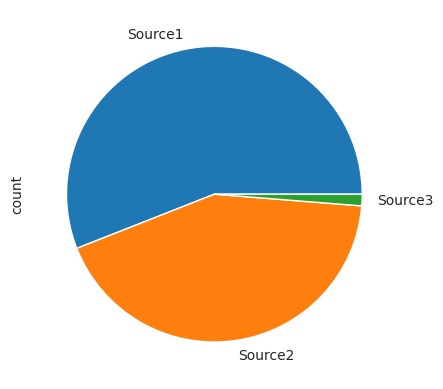

In [22]:
data['Source'].value_counts().plot(kind='pie')

# 3 - Start Latitude & Longitude¶

* Start latitude Shows latitude in GPS coordinate of the start point.
* Start longitude Shows longitude in GPS coordinate of the start point.¶

In [23]:
data.Start_Lat

0          39.865147
1          39.928059
2          39.063148
3          39.747753
4          39.627781
             ...    
7728389    34.002480
7728390    32.766960
7728391    33.775450
7728392    33.992460
7728393    34.133930
Name: Start_Lat, Length: 7728394, dtype: float64

In [24]:
data.Start_Lng

0          -84.058723
1          -82.831184
2          -84.032608
3          -84.205582
4          -84.188354
              ...    
7728389   -117.379360
7728390   -117.148060
7728391   -117.847790
7728392   -118.403020
7728393   -117.230920
Name: Start_Lng, Length: 7728394, dtype: float64

In [25]:
sample_data = data.sample(int(0.1 *len(data)))

#The line of code you provided is used to create a new DataFrame called sample_df by
#randomly sampling 10% of the rows from an existing DataFrame called df.

In [ ]:
sns.scatterplot(x = sample_data.Start_Lng , y = sample_data.Start_Lat )
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

In [27]:
pip install folium --quiet

Note: you may need to restart the kernel to use updated packages.


In [28]:
from folium.plugins import HeatMap

In [29]:
lat_lon_pairs = list(zip(list(sample_data.Start_Lat), list(sample_data.Start_Lng)))

#The lat_lon_pairs variable is created using the zip function, 
#which takes two lists of equal length (latitude and longitude values) 
#and combines them into a single list of tuples. 
#These tuples represent pairs of latitude and longitude coordinates.

In [30]:
map = folium.Map()
HeatMap(lat_lon_pairs).add_to(map)
map

In [31]:
new_data = data[data['City']==" New York"]
print(new_data.shape)

(0, 46)
